In [10]:
import os

import numpy as np
import scipy as sp
from matplotlib import pyplot as plt
from matplotlib.gridspec import GridSpec as gridspec
import dill

import suite2p as s2p

import TwoPUtils as tpu
import STX3KO_analyses as stx
from STX3KO_analyses import utilities as u

ko_mice = stx.ymaze_sess_deets.ko_mice
ctrl_mice = stx.ymaze_sess_deets.ctrl_mice


%matplotlib inline

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [15]:
def plot_cells(trial_mat, cell_inds=None, n_cols=20):
    '''

    :param ca1:
    :param cell_inds: indices of cells to plot
    :param save_figs:
    :return:
    '''

    if cell_inds is None:
        cell_inds = np.arange(trial_mat.shape[-1])

    n_rows = int(np.ceil(cell_inds.shape[0] / n_cols))
    fig = plt.figure(figsize=[30, 3 * n_rows])
    gs = gridspec(n_rows, n_cols)
    for cell in cell_inds:
        col = cell % n_cols
        row = int(cell / n_cols)
        ax = fig.add_subplot(gs[row, col])
        h = ax.imshow(trial_mat[:, :, cell], cmap="magma")

        if col == 0:
            ax.set_xlabel('pos')
            ax.set_ylabel('trial #')
            if row==0:
                plt.colorbar(h,ax=ax)
        else:
            ax.set_xticks([])
            ax.set_yticks([])
    fig.subplots_adjust(hspace=.3)
    return fig

{'date': '04_12_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 2, 'novel_arm': -1, 'ravel_ind': 5}


dict_keys(['block_number', 'LR'])

{'date': '04_12_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 2, 'novel_arm': -1, 'ravel_ind': 5}
-1


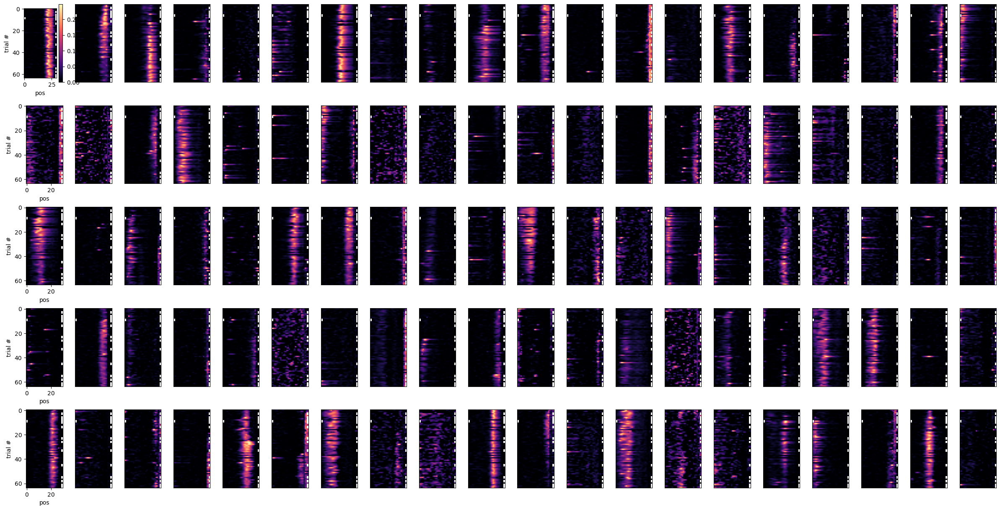

In [27]:
# only familiar arm from day 6
sess = u.load_single_day(ctrl_mice[0],5)
print(sess.novel_arm)
fig = plot_cells(sess.trial_matrices['spks'][sess.trial_info['LR']==-1*sess.novel_arm,:,:], cell_inds=np.array([r for r in range(100)]))

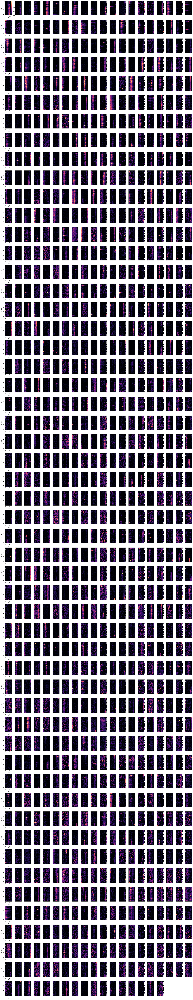

In [28]:
# only place cells
# novel arm is -1 (left)
fig = plot_cells(sess.trial_matrices['spks'][sess.trial_info['LR']==-1*sess.novel_arm,:,:][:,:,sess.place_cell_info['left']['masks']])

{'date': '03_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3, 'novel_arm': -1, 'ravel_ind': 6}


/home/mplitt/repos/TwoPUtils/TwoPUtils/sess.py:97: UserWarning: skipping checking keys, remaining initialization not guaranteed to work
  warnings.warn("skipping checking keys, remaining initialization not guaranteed to work")


-1


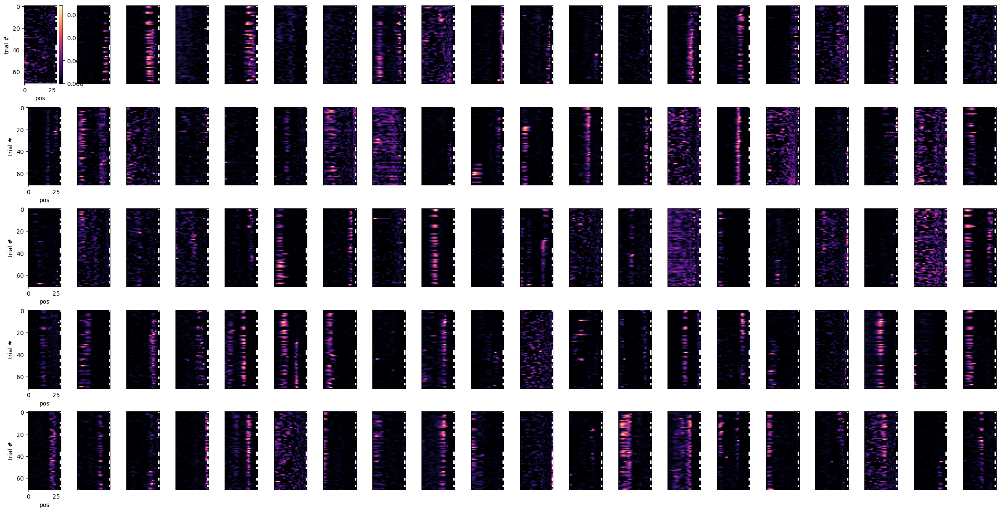

In [29]:
sess = u.load_single_day(ko_mice[0],5)
print(sess.novel_arm)
fig = plot_cells(sess.trial_matrices['spks'][sess.trial_info['LR']==-1*sess.novel_arm,:,:], cell_inds=np.array([r for r in range(100)]))